# Self-Driving Car Engineer Nanodegree

## Advanced Lane Finding Project

The goals / steps of this project are the following:

* Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
* Apply a distortion correction to raw images.
* Use color transforms, gradients, etc., to create a thresholded binary image.
* Apply a perspective transform to rectify binary image ("birds-eye view").
* Detect lane pixels and fit to find the lane boundary.
* Determine the curvature of the lane and vehicle position with respect to center.
* Warp the detected lane boundaries back onto the original image.
* Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

---

# Import Packages

In [1]:
import numpy as np
import cv2
import glob
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import pickle
import os
%matplotlib inline

# 1 - Caliberation


In [2]:
nx = 9
ny = 6

camera_cal_img_dir = "./camera_cal/"
camera_cal_output_dir = "./camera_cal_output/"

# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
objp = np.zeros((nx*ny,3), np.float32)
objp[:,:2] = np.mgrid[0:nx, 0:ny].T.reshape(-1,2)

# Arrays to store object points and image points from all the images.
objpoints = [] # 3d points in real world space
imgpoints = [] # 2d points in image plane.

# Make a list of calibration images
camera_cal_images = glob.glob(camera_cal_img_dir + '*.jpg')

# Step through the list and search for chessboard corners
for idx, fname in enumerate(camera_cal_images):
    img = cv2.imread(fname)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (nx,ny), None)

    # If found, add object points, image points
    if ret == True:
        objpoints.append(objp)
        imgpoints.append(corners)

        # Draw and display the corners
        cv2.drawChessboardCorners(img, (nx,ny), corners, ret)
        image_name = os.path.split(fname)[1]
        write_name = camera_cal_output_dir + 'cornersfound_' + image_name
        cv2.imwrite(write_name,img)
        #cv2.imshow('img', img)
        cv2.waitKey(500)

cv2.destroyAllWindows()

## test on images

Text(0.5,1,'Undistorted Image')

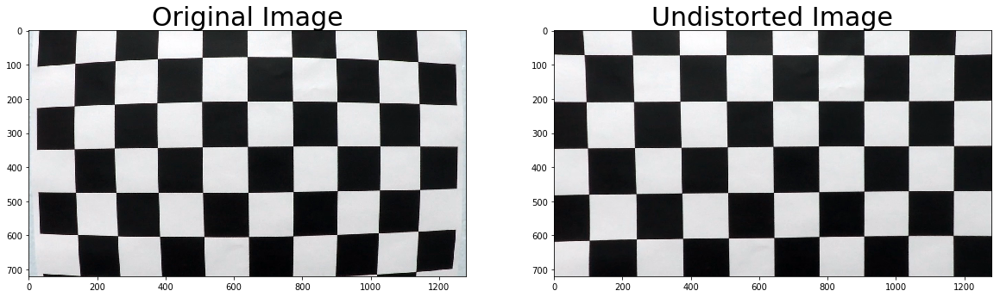

In [3]:
# Test undistortion on an image
img = cv2.imread(camera_cal_img_dir + 'calibration1.jpg')
img_size = (img.shape[1], img.shape[0])

# Do camera calibration given object points and image points
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img_size,None,None)
dst = cv2.undistort(img, mtx, dist, None, mtx)

f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
ax1.imshow(img)
ax1.set_title('Original Image', fontsize=30)
ax2.imshow(dst)
ax2.set_title('Undistorted Image', fontsize=30)

In [4]:
# Save the camera calibration result for later use (we won't worry about rvecs / tvecs) 
dist_pickle = {}
dist_pickle["mtx"] = mtx
dist_pickle["dist"] = dist
pickle.dump( dist_pickle, open( "wide_dist_pickle.p", "wb" ) )

In [5]:
undistorted_dir = "undistorted_images/"

# load pickled distortion matrix
with open('wide_dist_pickle.p', mode='rb') as f:
    dist_pickle = pickle.load(f)
    mtx = dist_pickle["mtx"]
    dist = dist_pickle["dist"]
    
# Visualize undistortion
# Step through the list and search for chessboard corners
for idx, fname in enumerate(camera_cal_images):
    img = cv2.imread(fname)
    dst = cv2.undistort(img, mtx, dist, None, mtx)
    image_name = os.path.split(fname)[1]
    os.makedirs(camera_cal_output_dir + undistorted_dir, exist_ok=True)
    write_name = camera_cal_output_dir + undistorted_dir + 'undistorted_' + image_name
    cv2.imwrite(write_name,dst)
    print(write_name)
    #cv2.imshow('dst', dst)
    cv2.waitKey(500)
cv2.destroyAllWindows()

./camera_cal_output/undistorted_images/undistorted_calibration1.jpg
./camera_cal_output/undistorted_images/undistorted_calibration10.jpg
./camera_cal_output/undistorted_images/undistorted_calibration11.jpg
./camera_cal_output/undistorted_images/undistorted_calibration12.jpg
./camera_cal_output/undistorted_images/undistorted_calibration13.jpg
./camera_cal_output/undistorted_images/undistorted_calibration14.jpg
./camera_cal_output/undistorted_images/undistorted_calibration15.jpg
./camera_cal_output/undistorted_images/undistorted_calibration16.jpg
./camera_cal_output/undistorted_images/undistorted_calibration17.jpg
./camera_cal_output/undistorted_images/undistorted_calibration18.jpg
./camera_cal_output/undistorted_images/undistorted_calibration19.jpg
./camera_cal_output/undistorted_images/undistorted_calibration2.jpg
./camera_cal_output/undistorted_images/undistorted_calibration20.jpg
./camera_cal_output/undistorted_images/undistorted_calibration3.jpg
./camera_cal_output/undistorted_image

## 2 - Apply a distortion correction to raw images.

straight_lines1.jpg
straight_lines2.jpg
test1.jpg
test2.jpg
test3.jpg
test4.jpg
test5.jpg
test6.jpg


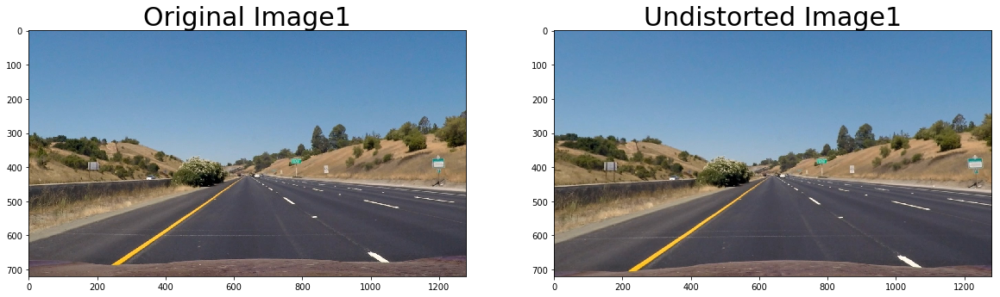

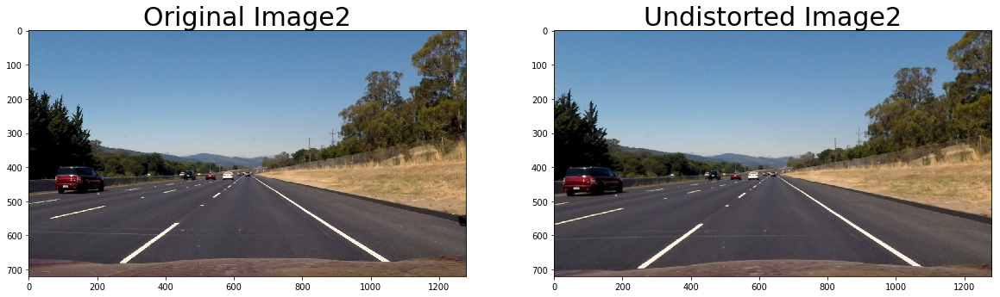

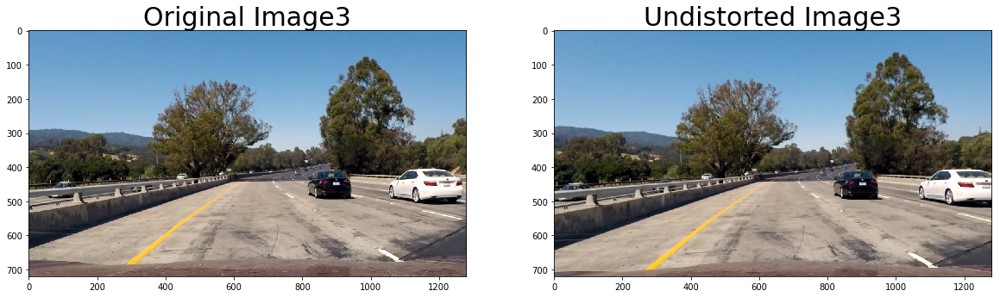

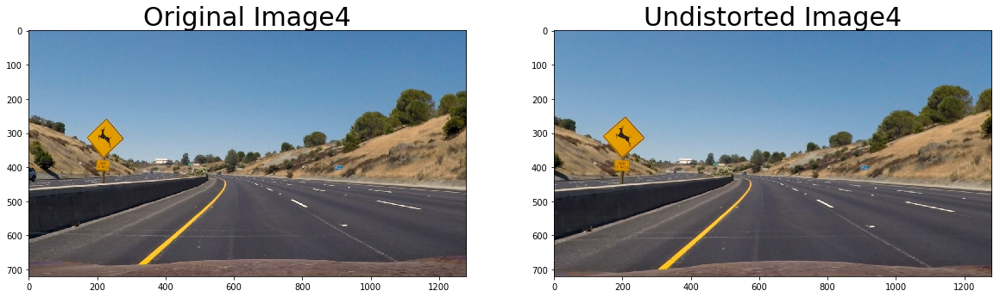

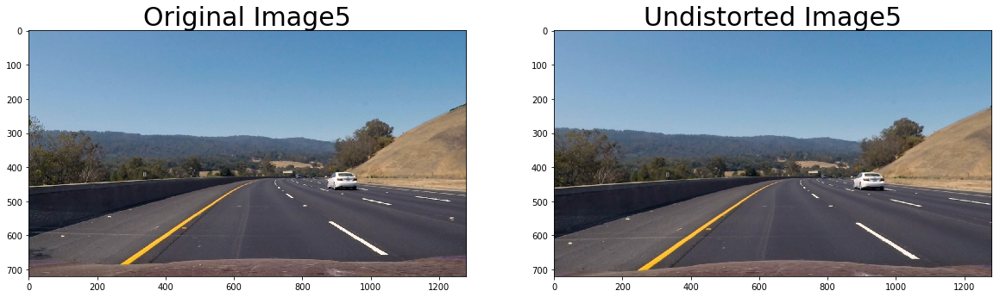

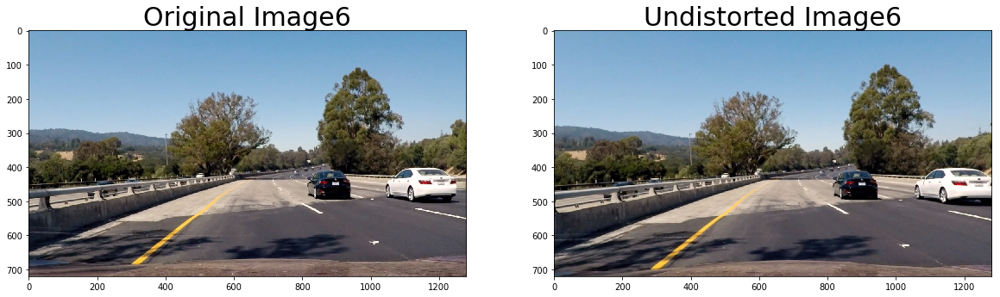

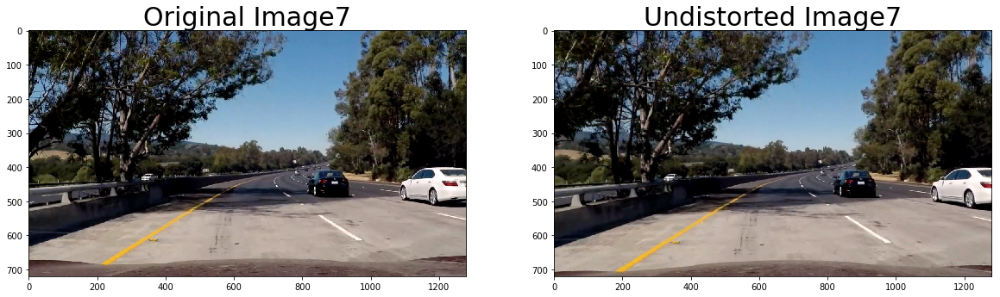

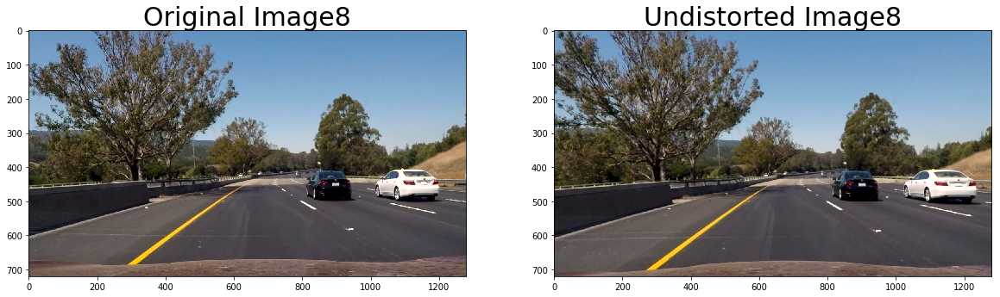

In [6]:
test_images_dir = "./test_images/"
output_images_dir = "./output_images/"
undistorted_dir = 'undistorted_images/'

test_images = glob.glob(test_images_dir + '*.jpg')

for idx, fname in enumerate(test_images):
    img = cv2.imread(fname)
    dst = cv2.undistort(img, mtx, dist, None, mtx)
    image_name=os.path.split(fname)[1]
    os.makedirs(output_images_dir + undistorted_dir, exist_ok=True)
    cv2.imwrite(output_images_dir + undistorted_dir + image_name ,dst)
    print(image_name)
    
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    ax1.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    ax1.set_title('Original Image' + str(idx+1), fontsize=30)
    ax2.imshow(cv2.cvtColor(dst, cv2.COLOR_BGR2RGB))
    ax2.set_title('Undistorted Image' + str(idx+1), fontsize=30)

cv2.destroyAllWindows()

# 3 - Gradients and color transforms

I used 5 kinds of gradient thresholds:

1. Along the X and Y axis.
2. Directional gradient with thresholds of 0.7 and 1.3 degrees.
3. Magnitude of the Gradient with thresholds of 30 and 100.
4. S channel threshold since it picks up the lines well.
5. L channel threshold.

In [7]:
def abs_sobel_thresh(gray, orient='x', sobel_thresh=(0, 255)):
    # Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # Take the derivative in x or y given orient = 'x' or 'y'
    if orient == 'x':
        sobel = cv2.Sobel(gray, cv2.CV_64F, 1, 0)
    else:
        sobel = cv2.Sobel(gray, cv2.CV_64F, 0, 1)
    # Take the absolute value of the derivative or gradient
    abs_sobel = np.absolute(sobel)
    # Scale to 8-bit (0 - 255) then convert to type = np.uint8
    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
    # Create a mask of 1's where the scaled gradient magnitude
    grad_binary = np.zeros_like(scaled_sobel)
    grad_binary[(scaled_sobel >= sobel_thresh[0]) & (scaled_sobel <= sobel_thresh[1])] = 1
    # Return this mask as your binary_output image
    return grad_binary

def mag_thresh(gray, sobel_kernel=3, mag_thresh=(0, 255)):
    # Take the gradient in x and y separately
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # Calculate the magnitude
    gradmag = np.sqrt(sobelx**2 + sobely**2)
    # Scale to 8-bit (0 - 255) and convert to type = np.uint8
    scale_factor = np.max(gradmag)/255
    gradmag = (gradmag/scale_factor).astype(np.uint8)
    # Create a binary mask where mag thresholds are met
    mag_binary = np.zeros_like(gradmag)
    mag_binary[(gradmag >= mag_thresh[0]) & (gradmag <= mag_thresh[1])] = 1
    # Return this mask as your binary_output image
    return mag_binary

def dir_threshold(gray, sobel_kernel=3, thresh=(0, np.pi/2)):
    # Take the gradient in x and y separately
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # Take the absolute value of the x and y gradients
    # Use np.arctan2(abs_sobely, abs_sobelx) to calculate the direction of the gradient 
    absgraddir = np.arctan2(np.absolute(sobely), np.absolute(sobelx))
    # Create a binary mask where direction thresholds are met
    # Return this mask as your binary_output image
    dir_binary =  np.zeros_like(absgraddir)
    dir_binary[(absgraddir >= thresh[0]) & (absgraddir <= thresh[1])] = 1
    return dir_binary

def get_thresholded_image(img):
    # Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    height, width = gray.shape
    
    ksize = 15 # Choose a larger odd number to smooth gradient measurements
    
    gradx = abs_sobel_thresh(gray, orient='x', sobel_thresh=(10, 200))
    grady = abs_sobel_thresh(gray, orient='y', sobel_thresh=(10, 200))

    mag_binary = mag_thresh(gray, sobel_kernel=ksize, mag_thresh=(30, 100))
    
    dir_binary = dir_threshold(gray, sobel_kernel=ksize, thresh=(0.7, 1.3))
    
    # combine the gradient , magnitude thresolds and direction thresholds.
    combined_condition = ((gradx == 1) & (grady == 1) | (mag_binary == 1) & (dir_binary == 1))
    
    # color channel thresholds
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    s_channel = hls[:,:,2]
    l_channel = hls[:,:,1]
    
    # Threshold color channel
    s_thresh = (170, 255)
    s_condition = (s_channel > s_thresh[0]) & (s_channel <= s_thresh[1])
    
    
    # We put a threshold on the L channel to avoid pixels which have shadows and as a result darker.
    l_thresh = (120, 255)
    l_condition = (l_channel > l_thresh[0]) & (l_channel <= l_thresh[1])
    
    color_combined = np.zeros_like(s_channel)
    color_combined[(l_condition & (s_condition | combined_condition))] = 1
    
    return color_combined

## Test on Images

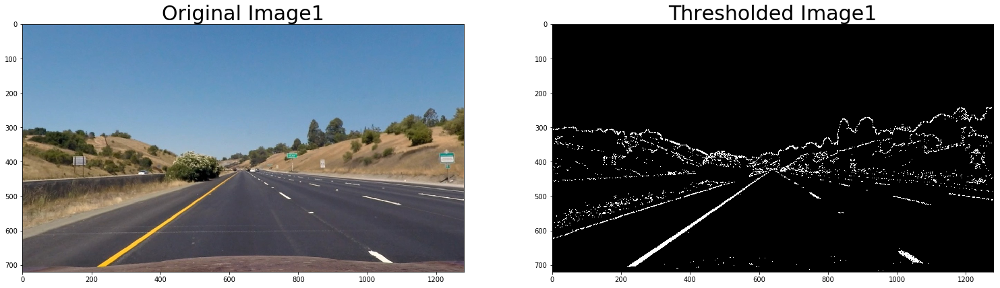

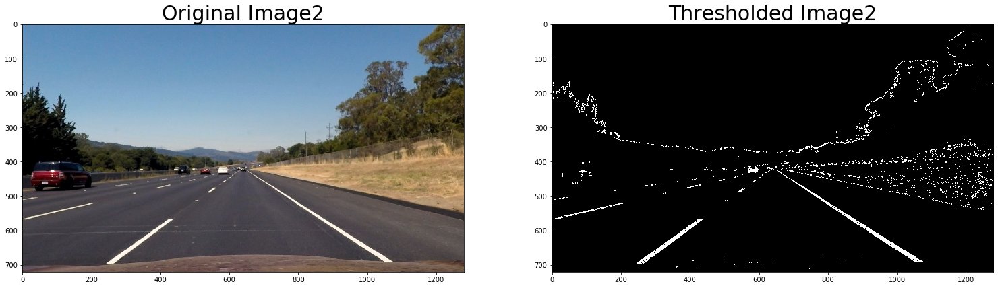

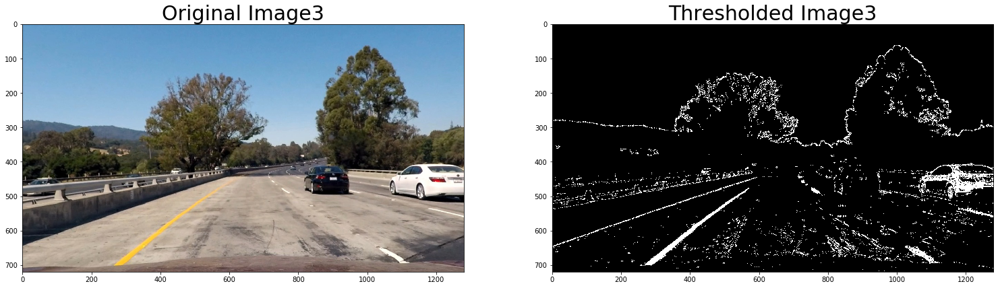

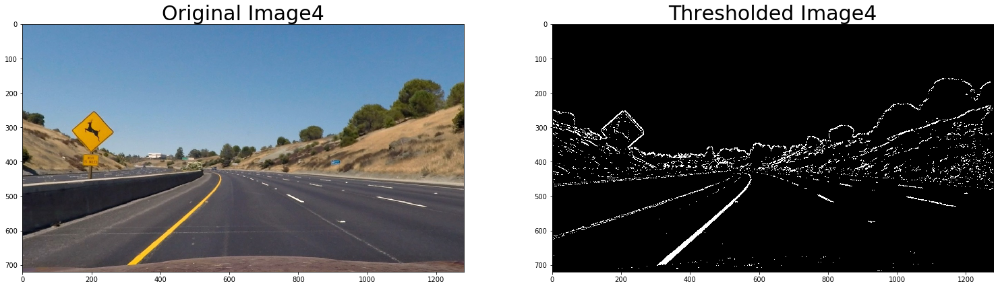

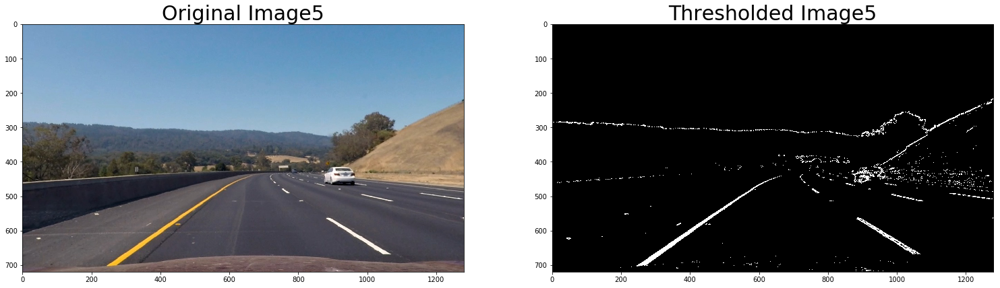

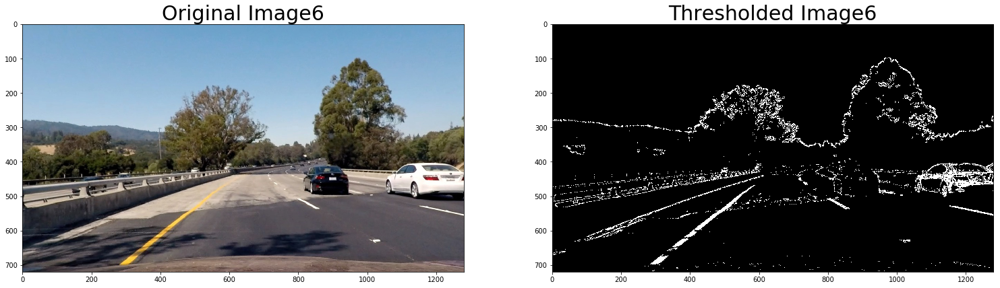

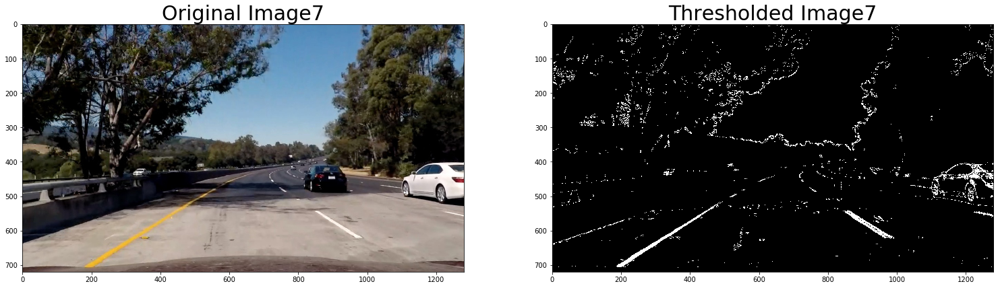

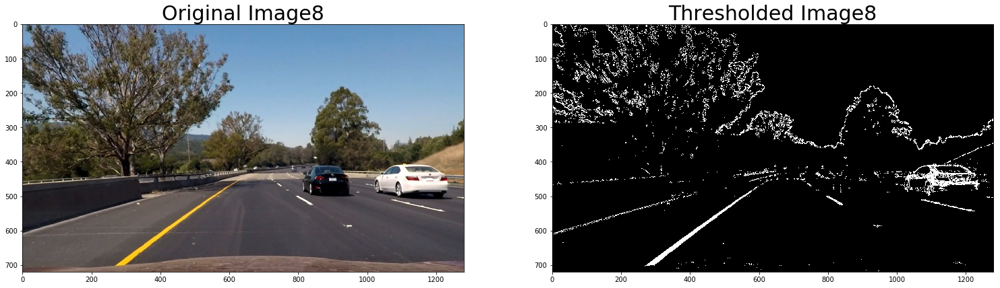

In [8]:
thresholded_dir = 'thresholded_images/'
undistorted_images = glob.glob(output_images_dir + undistorted_dir + '*.jpg')

for idx, fname in enumerate(undistorted_images):
    img = cv2.imread(fname)
    thresholded = get_thresholded_image(img)
    image_name=os.path.split(fname)[1]
    os.makedirs(output_images_dir + thresholded_dir, exist_ok=True)
    cv2.imwrite(output_images_dir + thresholded_dir + image_name ,thresholded)
    
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    ax1.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    ax1.set_title('Original Image' + str(idx+1), fontsize=30)
    ax2.imshow(thresholded, cmap='gray')
    ax2.set_title('Thresholded Image' + str(idx+1), fontsize=30)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

cv2.destroyAllWindows()

## 4 - Perspective transform to rectify binary image ("birds-eye view").

In [9]:
# Define perspective transform function
def get_warped_image(img, trans=True):
    
    # Define calibration box in source (original) and destination (desired and warped) coordinates
    img_size = (img.shape[1], img.shape[0])
    
    # Four source coordinates
    bottom_left = [220,720]
    bottom_right = [1110, 720]
    top_left = [570, 470]
    top_right = [722, 470]

    src = np.float32([bottom_left,bottom_right,top_right,top_left])

    pts = np.array([bottom_left,bottom_right,top_right,top_left], np.int32)
    pts = pts.reshape((-1,1,2))
    copy = img.copy()
    cv2.polylines(copy,[pts],True,(255,0,0), thickness=3)
    
    # Four desired coordinates
    bottom_left = [320,720]
    bottom_right = [920, 720]
    top_left = [320, 1]
    top_right = [920, 1]

    dst = np.float32([bottom_left,bottom_right,top_right,top_left])
    
    if trans:
        # compute the perspective transform M
        M = cv2.getPerspectiveTransform(src, dst)
    else:
        # Could compute the inverse also by swaping the input parameters
        M = cv2.getPerspectiveTransform(dst, src)
    
    # Create warped image - uses linear interpotation
    warped = cv2.warpPerspective(img, M, img_size , flags=cv2.INTER_LINEAR)
    
    return warped


## Test on Images

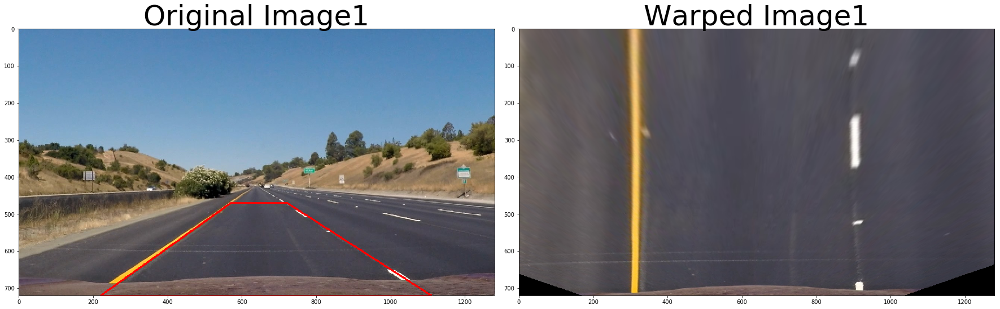

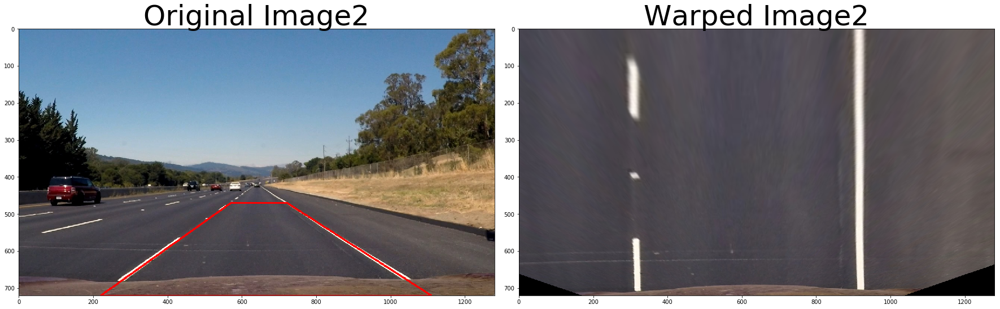

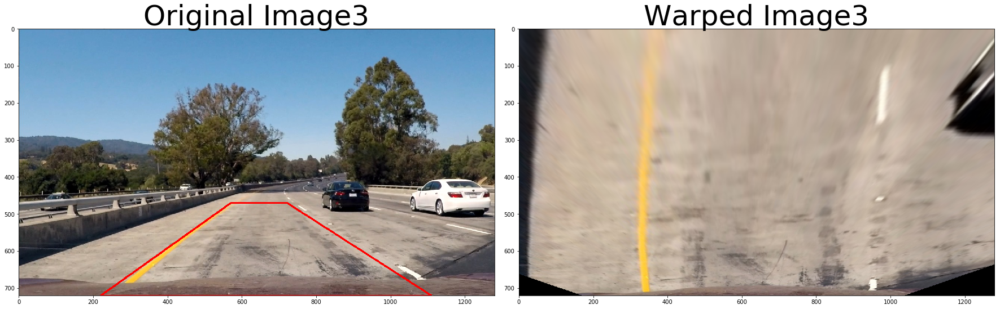

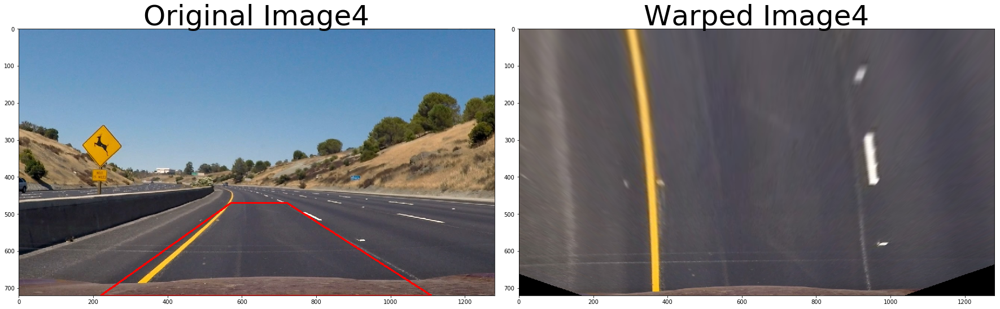

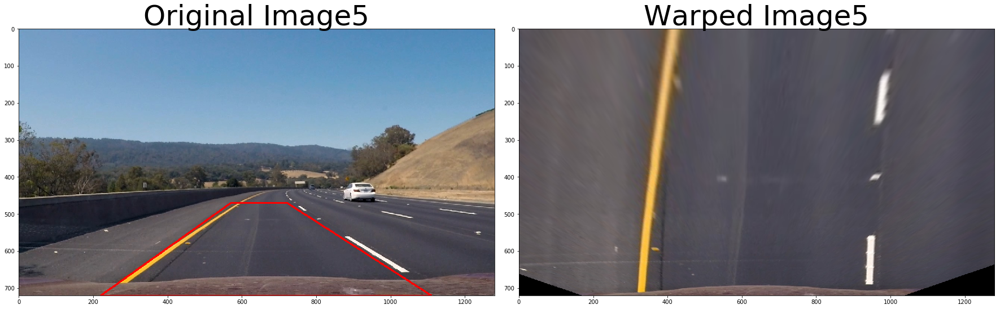

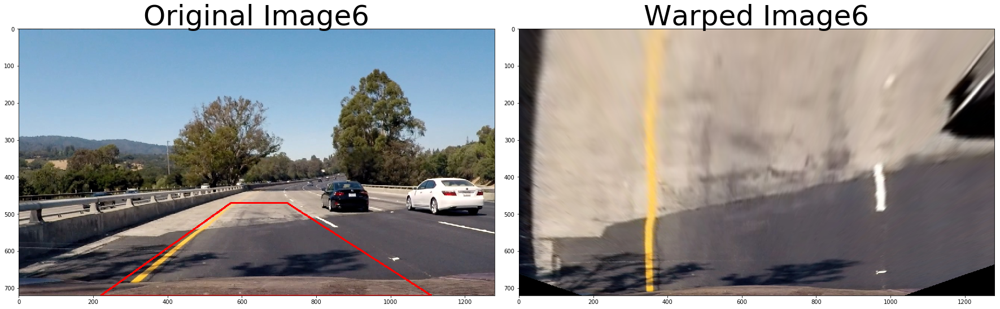

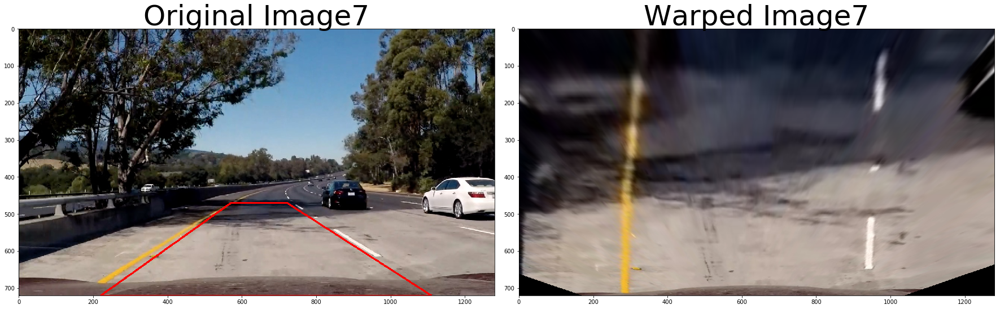

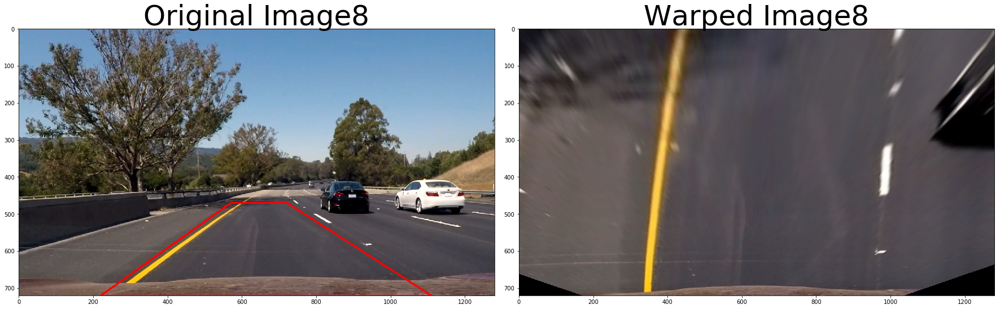

In [10]:
original_images = glob.glob(test_images_dir + '*.jpg')
warped_dir = 'warped_images/'

for idx, fname in enumerate(original_images):
    img = cv2.imread(fname)
    dst = cv2.undistort(img, mtx, dist, None, mtx)
    #thresholded = get_thresholded_image(dst)
    warped = get_warped_image(dst)
    image_name=os.path.split(fname)[1]
    os.makedirs(output_images_dir + warped_dir, exist_ok=True)
    cv2.imwrite(output_images_dir + warped_dir + image_name ,warped)
    
    # Four source coordinates
    bottom_left = [220,720]
    bottom_right = [1110, 720]
    top_left = [570, 470]
    top_right = [722, 470]

    src = np.float32([bottom_left,bottom_right,top_right,top_left])
    pts = np.array([bottom_left,bottom_right,top_right,top_left], np.int32)
    pts = pts.reshape((-1,1,2))
    copy = img.copy()
    cv2.polylines(copy,[pts],True,(0,0,255), thickness=3)
    
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(cv2.cvtColor(copy, cv2.COLOR_BGR2RGB))
    ax1.set_title('Original Image' + str(idx+1), fontsize=50)
    ax2.imshow(cv2.cvtColor(warped, cv2.COLOR_BGR2RGB))
    ax2.set_title('Warped Image' + str(idx+1), fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

cv2.destroyAllWindows()

## 5 - Detect lane pixels and fit to find the lane boundary.

### 5-1 Finding the Lines: Histogram Peaks

In [11]:
def hist(img):
    # Grab only the bottom half of the image
    # Lane lines are likely to be mostly vertical nearest to the car
    bottom_half = img[img.shape[0]//2:,:]

    # Sum across image pixels vertically - make sure to set an `axis`
    # i.e. the highest areas of vertical lines should be larger values
    histogram = np.sum(bottom_half, axis=0)
    return histogram

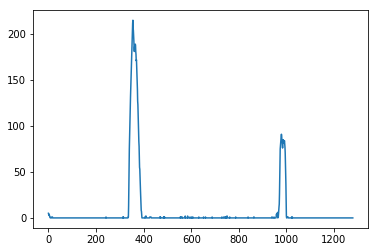

In [12]:
img = mpimg.imread('test_images/test6.jpg')
dst = cv2.undistort(img, mtx, dist, None, mtx)
thresholded = get_thresholded_image(dst)
warped = get_warped_image(thresholded)
histogram = hist(warped)
plt.plot(histogram)

### 5-2 Finding the Lines: Sliding Window

In [13]:
def find_lane_pixels(binary_warped):
    # Take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[binary_warped.shape[0]//2:,:], axis=0)
    # Create an output image to draw on and visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]//2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # HYPERPARAMETERS
    # Choose the number of sliding windows
    nwindows = 9
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50

    # Set height of windows - based on nwindows above and image shape
    window_height = np.int(binary_warped.shape[0]//nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated later for each window in nwindows
    leftx_current = leftx_base
    rightx_current = rightx_base

    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        
        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),
        (win_xleft_high,win_y_high),(0,255,0), 2) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),
        (win_xright_high,win_y_high),(0,255,0), 2) 
        
        # Identify the nonzero pixels in x and y within the window #
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xright_low) &  (nonzerox < win_xright_high)).nonzero()[0]
        
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices (previously was a list of lists of pixels)
    try:
        left_lane_inds = np.concatenate(left_lane_inds)
        right_lane_inds = np.concatenate(right_lane_inds)
    except ValueError:
        # Avoids an error if the above is not implemented fully
        pass

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]

    return leftx, lefty, rightx, righty, out_img


def fit_polynomial(binary_warped):
    # Find our lane pixels first
    leftx, lefty, rightx, righty, out_img = find_lane_pixels(binary_warped)

    # Fit a second order polynomial to each using `np.polyfit`
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)

    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    try:
        left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    except TypeError:
        # Avoids an error if `left` and `right_fit` are still none or incorrect
        print('The function failed to fit a line!')
        left_fitx = 1*ploty**2 + 1*ploty
        right_fitx = 1*ploty**2 + 1*ploty

    ## Visualization ##
    # Colors in the left and right lane regions
    out_img[lefty, leftx] = [255, 0, 0]
    out_img[righty, rightx] = [0, 0, 255]

    # Plots the left and right polynomials on the lane lines
    plt.plot(left_fitx, ploty, color='yellow')
    plt.plot(right_fitx, ploty, color='yellow')

    return out_img

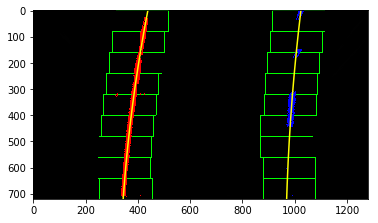

In [14]:
img = mpimg.imread('test_images/test6.jpg')
dst = cv2.undistort(img, mtx, dist, None, mtx)
thresholded = get_thresholded_image(dst)
warped = get_warped_image(thresholded)

out_img = fit_polynomial(warped)

plt.imshow(out_img)

### 5-3 Finding the Lines: Search from Prior

In [15]:
def fit_poly(img_shape, leftx, lefty, rightx, righty):
    if leftx.size == 0:
        left_fitx = None
        right_fitx = None
        ploty = None
    else:
        left_fit = np.polyfit(lefty, leftx, 2)
        right_fit = np.polyfit(righty, rightx, 2)
        # Generate x and y values for plotting
        ploty = np.linspace(0, img_shape[0]-1, img_shape[0])
    
        left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    return left_fitx, right_fitx, ploty

def search_around_poly(binary_warped):
    # HYPERPARAMETER
    # Choose the width of the margin around the previous polynomial to search
    # The quiz grader expects 100 here, but feel free to tune on your own!
    margin = 100
    # Polynomial fit values from the previous frame
    # Make sure to grab the actual values from the previous step in your project!
    left_fit = np.array([ 2.13935315e-04, -3.77507980e-01,  4.76902175e+02])
    right_fit = np.array([4.17622148e-04, -4.93848953e-01,  1.11806170e+03])

    # Grab activated pixels
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    
    ### TO-DO: Set the area of search based on activated x-values ###
    ### within the +/- margin of our polynomial function ###
    ### Hint: consider the window areas for the similarly named variables ###
    ### in the previous quiz, but change the windows to our new search area ###
    left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + 
                    left_fit[2] - margin)) & (nonzerox < (left_fit[0]*(nonzeroy**2) + 
                    left_fit[1]*nonzeroy + left_fit[2] + margin)))
    right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + 
                    right_fit[2] - margin)) & (nonzerox < (right_fit[0]*(nonzeroy**2) + 
                    right_fit[1]*nonzeroy + right_fit[2] + margin)))
    
    # Again, extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]
    
    if leftx.size == 0 or lefty.size == 0 or rightx.size == 0 or righty.size == 0 :
        left_fitx,right_fitx,ploty = search_lane(warped)
    else:
        # Fit new polynomials
        left_fitx, right_fitx, ploty = fit_poly(binary_warped.shape, leftx, lefty, rightx, righty)
    
    ## Visualization ##
    # Create an image to draw on and an image to show the selection window
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    window_img = np.zeros_like(out_img)
    # Color in left and right line pixels
    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]

    # Generate a polygon to illustrate the search window area
    # And recast the x and y points into usable format for cv2.fillPoly()
    left_line_window1 = np.array([np.transpose(np.vstack([left_fitx-margin, ploty]))])
    left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx+margin, 
                              ploty])))])
    left_line_pts = np.hstack((left_line_window1, left_line_window2))
    right_line_window1 = np.array([np.transpose(np.vstack([right_fitx-margin, ploty]))])
    right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx+margin, 
                              ploty])))])
    right_line_pts = np.hstack((right_line_window1, right_line_window2))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(window_img, np.int_([left_line_pts]), (0,255, 0))
    cv2.fillPoly(window_img, np.int_([right_line_pts]), (0,255, 0))
    result = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)
    
    return result, left_fitx, right_fitx, ploty

(720, 0)

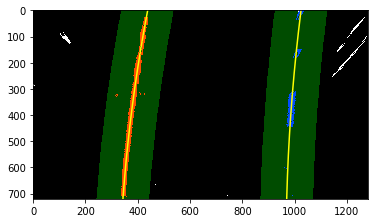

In [16]:
img = mpimg.imread('test_images/test6.jpg')
dst = cv2.undistort(img, mtx, dist, None, mtx)
thresholded = get_thresholded_image(dst)
warped = get_warped_image(thresholded)

result, left_fitx, right_fitx, ploty = search_around_poly(warped)

plt.imshow(result)
plt.plot(left_fitx, ploty, color='yellow')
plt.plot(right_fitx, ploty, color='yellow')
plt.xlim(0, warped.shape[1])
plt.ylim(warped.shape[0],0)

## 6 - Determine the curvature of the lane and vehicle position with respect to center.

In [17]:
def measure_radius_of_curvature(x_values, warped):
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension
    # If no pixels were found return None
    y_points = np.linspace(0, warped.shape[0]-1, warped.shape[0])
    y_eval = np.max(y_points)
    # Fit new polynomials to x,y in world space
    fit_cr = np.polyfit(y_points*ym_per_pix, x_values*xm_per_pix, 2)
    curverad = ((1 + (2*fit_cr[0]*y_eval*ym_per_pix + fit_cr[1])**2)**1.5) / np.absolute(2*fit_cr[0])
    return curverad

In [18]:
img = mpimg.imread('test_images/test6.jpg')
dst = cv2.undistort(img, mtx, dist, None, mtx)
thresholded = get_thresholded_image(dst)
warped = get_warped_image(thresholded)

result, left_fitx, right_fitx, ploty = search_around_poly(warped)

left_curve_rad = measure_radius_of_curvature(left_fitx, warped)
right_curve_rad = measure_radius_of_curvature(right_fitx, warped)
average_curve_rad = (left_curve_rad + right_curve_rad)/2
curvature_string = "Radius of curvature: %.2f m" % average_curve_rad
print(curvature_string)

# compute the offset from the center
lane_center = (right_fitx[719] + left_fitx[719])/2
xm_per_pix = 3.7/700 # meters per pixel in x dimension
center_offset_pixels = abs(img_size[0]/2 - lane_center)
center_offset_mtrs = xm_per_pix*center_offset_pixels
offset_string = "Center offset: %.2f m" % center_offset_mtrs
print(offset_string)

Radius of curvature: 2182.71 m
Center offset: 0.09 m


## 7 - Warp the detected lane boundaries back onto the original image.

In [19]:
def draw_poly(img, warped, left_fitx, right_fitx):
    out_img = np.dstack((warped, warped, warped))*255
    
    ploty = np.linspace(0, warped.shape[0]-1, warped.shape[0])
    
    left_line_window = np.array(np.transpose(np.vstack([left_fitx, ploty])))
    right_line_window = np.array(np.flipud(np.transpose(np.vstack([right_fitx, ploty]))))
    line_points = np.vstack((left_line_window, right_line_window))
    
    cv2.fillPoly(out_img, np.int_([line_points]), [0,255, 0])
    unwarped= get_warped_image(out_img, trans=False)
    result = cv2.addWeighted(img, 1, unwarped, 0.3, 0)
    
    return result

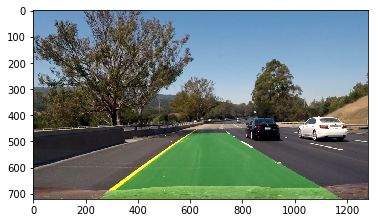

In [20]:
img = mpimg.imread('test_images/test6.jpg')
dst = cv2.undistort(img, mtx, dist, None, mtx)
thresholded = get_thresholded_image(dst)
warped = get_warped_image(thresholded)
poly_img, left_fitx, right_fitx, ploty = search_around_poly(warped)

result = draw_poly(img, warped, left_fitx, right_fitx)
plt.imshow(result)

## 8 - Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

In [21]:
def search_lane(binary_warped):
    # Find our lane pixels first
    leftx, lefty, rightx, righty, out_img = find_lane_pixels(binary_warped)

    # Fit a second order polynomial to each using `np.polyfit`
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)

    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    try:
        left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    except TypeError:
        # Avoids an error if `left` and `right_fit` are still none or incorrect
        print('The function failed to fit a line!')
        left_fitx = 1*ploty**2 + 1*ploty
        right_fitx = 1*ploty**2 + 1*ploty

    return left_fitx, right_fitx, ploty

In [22]:
def pipeline(img):
    
    dst = cv2.undistort(img, mtx, dist, None, mtx)
    # get thresholded image
    thresholded = get_thresholded_image(dst)
    
    # perform a perspective transform
    warped = get_warped_image(thresholded)
    _,left_fitx,right_fitx,_ = search_around_poly(warped)
    result = draw_poly(img, warped, left_fitx, right_fitx)
    
    # compute the radius of curvature
    left_curve_rad = measure_radius_of_curvature(left_fitx, warped)
    right_curve_rad = measure_radius_of_curvature(right_fitx, warped)
    average_curve_rad = (left_curve_rad + right_curve_rad)/2
    curvature_string = "Radius of curvature: %.2f m" % average_curve_rad
    
    # compute the offset from the center
    lane_center = (right_fitx[img.shape[0]-1] + left_fitx[img.shape[0]-1])/2
    xm_per_pix = 3.7/700 # meters per pixel in x dimension
    center_offset_pixels = abs(img.shape[1]/2 - lane_center)
    center_offset_mtrs = xm_per_pix*center_offset_pixels
    offset_string = "Center offset: %.2f m" % center_offset_mtrs
    
    cv2.putText(result,curvature_string , (100, 90), cv2.FONT_HERSHEY_SIMPLEX, 1.5, (255,255,255), thickness=2)

    cv2.putText(result, offset_string, (100, 150), cv2.FONT_HERSHEY_SIMPLEX, 1.5, (255,255,255), thickness=2)
    
    return result

## Test on Images

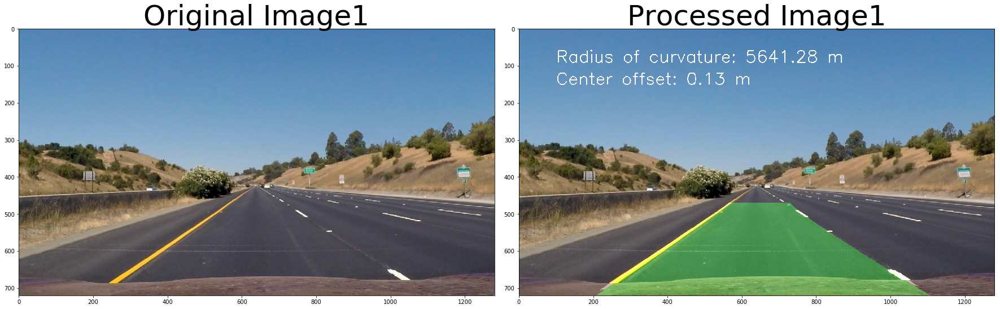

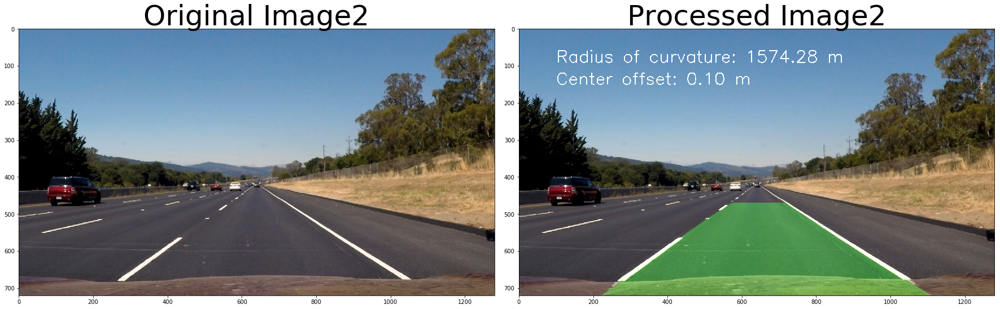

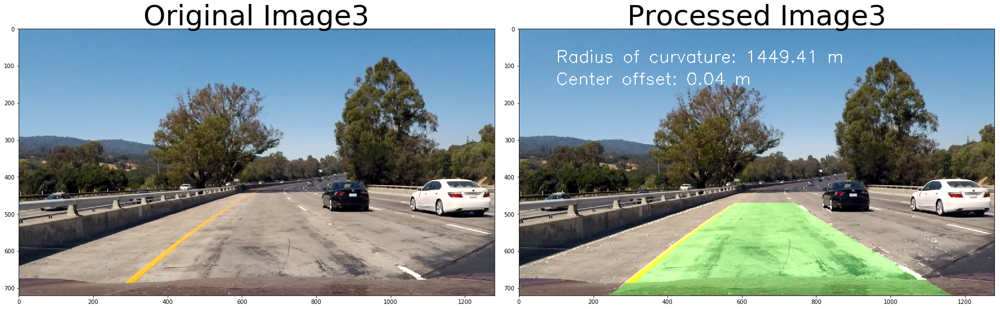

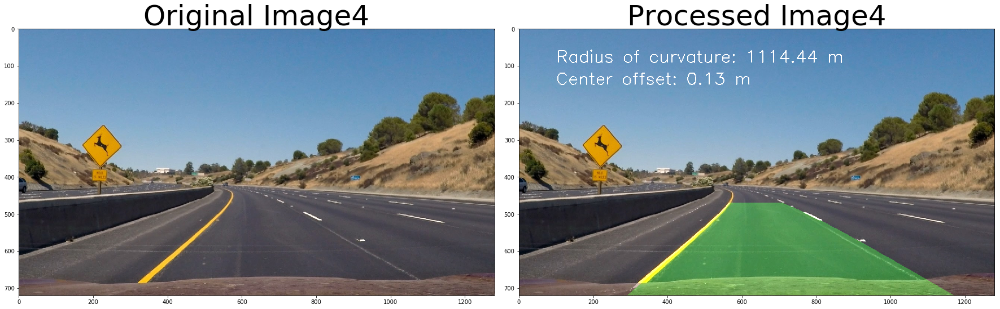

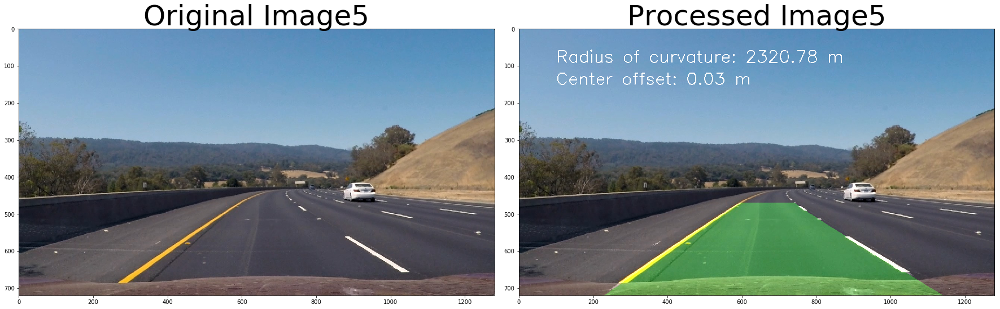

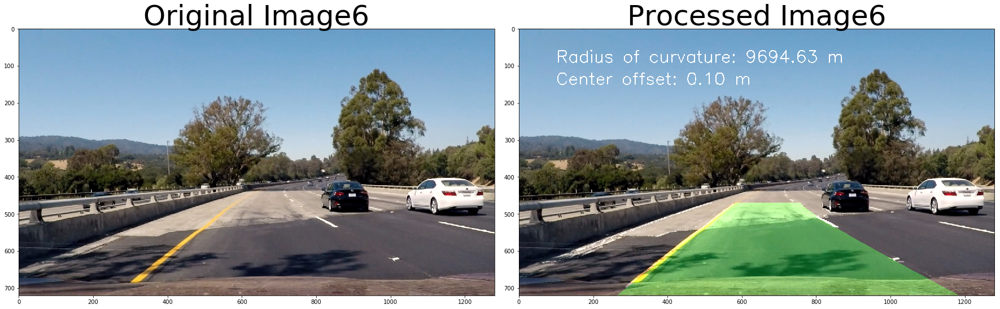

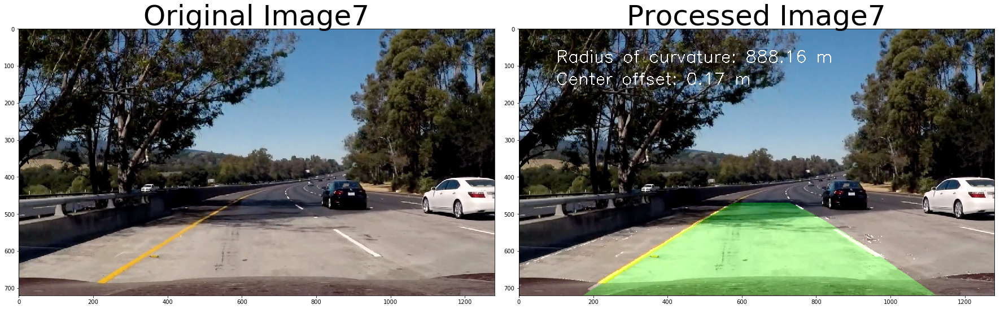

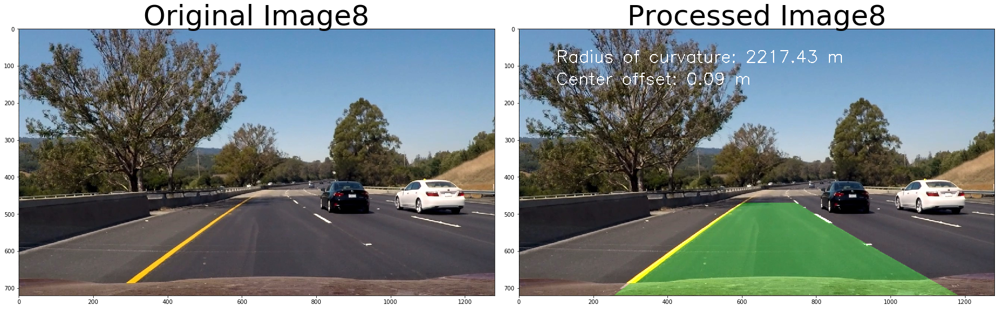

In [23]:
output_images_dir = "./output_images/"
processed_dir = 'processed_images/'

original_images = glob.glob(test_images_dir + '*.jpg')

for idx, fname in enumerate(original_images):
    img = cv2.imread(fname)
    # Apply pipeline
    processed = pipeline(img)
    image_name=os.path.split(fname)[1]
    os.makedirs(output_images_dir + processed_dir, exist_ok=True)
    cv2.imwrite(output_images_dir + processed_dir + image_name ,processed)
    
    # Plot the 2 images
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    ax1.set_title('Original Image'+ str(idx+1), fontsize=50)
    ax2.imshow(cv2.cvtColor(processed, cv2.COLOR_BGR2RGB))
    ax2.set_title('Processed Image'+ str(idx+1), fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

cv2.destroyAllWindows()

## Test on Videos

In [24]:
# Import everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from IPython.display import HTML

In [25]:
output = 'project_video_output.mp4'
clip1 = VideoFileClip("project_video.mp4")
white_clip = clip1.fl_image(pipeline) #NOTE: this function expects color images!!
%time white_clip.write_videofile(output, audio=False)

[MoviePy] >>>> Building video project_video_output.mp4
[MoviePy] Writing video project_video_output.mp4


100%|█████████████████████████████████████████████████████████████████████████████▉| 1260/1261 [09:10<00:00,  2.29it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: project_video_output.mp4 

Wall time: 9min 13s


In [26]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(output))

In [27]:
challenge_output = 'challenge_video_output.mp4'
clip2 = VideoFileClip("challenge_video.mp4")
challenge_clip = clip2.fl_image(pipeline) #NOTE: this function expects color images!!
%time challenge_clip.write_videofile(challenge_output, audio=False)

[MoviePy] >>>> Building video challenge_video_output.mp4
[MoviePy] Writing video challenge_video_output.mp4


100%|████████████████████████████████████████████████████████████████████████████████| 485/485 [03:16<00:00,  2.47it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: challenge_video_output.mp4 

Wall time: 3min 18s


In [28]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(challenge_output))

In [29]:
harder_challenge_output = 'harder_challenge_video_output.mp4'
clip3 = VideoFileClip("harder_challenge_video.mp4")
harder_challenge_clip = clip3.fl_image(pipeline) #NOTE: this function expects color images!!
%time harder_challenge_clip.write_videofile(harder_challenge_output, audio=False)

[MoviePy] >>>> Building video harder_challenge_video_output.mp4
[MoviePy] Writing video harder_challenge_video_output.mp4


100%|█████████████████████████████████████████████████████████████████████████████▉| 1199/1200 [09:35<00:00,  2.08it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: harder_challenge_video_output.mp4 

Wall time: 9min 38s


In [30]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(harder_challenge_output))